In [1]:
%matplotlib inline

In [2]:
# Imported libraries
import matplotlib.pyplot as plt
import numpy as np
import plotly.graph_objects as go
import sys
import time

In [3]:
# Imported python files
from functions import *
from input_variables import *

# IMPROVED OPEN-PIT BENCH BLASTING DESIGN, BASED ON OPTIMIZATION AND MONTE CARLO SIMULATION
# Vol. 2. Blast design optimization

## Objective function
As we already know, one of the key aspects of efficient mining is blasting rockmass in a cost efficient way. Hence, in order to estimate the best design pattern for blasting, as well the best charging rule, this requires the definition of a minimization problem, concerning all mining costs. A general understanding of the problem is that the better the fragmentation, the higher the costs for drilling and blasting, while at the same time the lower the costs for excavating, hauling, crushing and grinding. This can be seen on the picture below.

<img src="https://media.licdn.com/dms/image/C4E12AQGgj6zp4hnoSA/article-inline_image-shrink_1000_1488/0/1611172143457?e=1691020800&v=beta&t=AfmlZOcHzIQpWBB9noU1KeuHxTkuHNMvB4C41Cz16Ek"  width="50%">

Therefore, the optimal solution lies somewhere between a low and high degree of fragmentation. Hence, based on what we already know, the main design parameters which can affect rock fragmentation and therfore lead to reduced costs are:
* Burden
* Spacing
* Subdrilling
* Stemming
* Type of drilling pattern

The objective function was defined as the sum of all mining costs, based on different design patterns and charging rules, which derive from the parameters above. The formal definition of the objective function is as follows:

$C_{mining} = C_{drilling} + C_{blasting} + C_{loading} + C_{hauling} \rightarrow min$

This is implemented in the complex function below. which takes all the calculations from the previous notebook and puts in them into a compound function, which calculates and returns the overall results and design features for each alternative. The results from the function are stored in a dictionary of the current solution. 

In [4]:
def mining_ops(bp_burden, bp_spacing, bp_dh_subdrilling, bp_dh_stemming):
    # Caluclates total mining costs, based on blast deisng parameters and global variables for mining equipment, prices, 
    # rockmass properties and blast panel features
    
    charge =  calc_bp_dh_charge(bp_burden, bp_spacing, bp_height, 
                                bp_dh_subdrilling, bp_dh_stemming, bp_dh_diameter, expl_density)
    bp_dh_length = charge["DH length, m"]
    bp_dh_exp_length = charge["DH charge length, m"]
    bp_dh_exp_mass = charge["DH charge mass, kg"]
    bp_dh_spec_charge = charge["DH spec. charge, kg/m³"]
    
    bp_total = calc_bp_total(bp_height, bp_width, bp_length, bp_slope_angle, 
                             bp_burden, bp_spacing, bp_dh_length, bp_dh_exp_mass)
    bp_dh_rows_cnt = bp_total["Rows"]
    bp_dh_per_row_cnt = bp_total["DHs per row"]
    bp_total_dh_cnt = bp_total["Total DH count"]
    bp_total_dh_length = bp_total["Total DH length, m"]
    bp_total_volume = bp_total["Total rock volume, m³"]
    bp_total_exp_mass = bp_total["Total explosive mass, kg"]
    
    frag_uniformity_idx_mod = calc_uniformity_idx_mod(bp_burden, bp_spacing, 
                                                      bp_dh_diameter, bp_dh_exp_length, bp_dh_dev, bp_height, rm_rock_factor)
    frag_x50 = calc_x50(bp_dh_exp_mass, bp_dh_spec_charge, rm_rock_factor, expl_rws)
    frag_oversize = 100 - kuz_ram_model(frag_uniformity_idx_mod, frag_x50, 1000)
    
    loader_fill_factor = set_fill_factor(frag_x50)
    loader_h_prod = 3600 / loader_s_cycle * loader_fill_factor * loader_bucket_vol / rm_swell_factor

    truck_tr_t = calc_truck_tr_t(loader_bucket_vol, rm_density, rm_swell_factor, loader_fill_factor, truck_cap_t)
    truck_h_prod =  truck_tr_t * (60 / truck_min_haul)
    
    costs_drilling = calc_drilling(bp_total_dh_length, drill_h_rate, drill_h_costs)["Costs"]
    costs_blasting = calc_blasting(bp_total_exp_mass, expl_price)["Costs"]
    costs_loading = calc_loading(bp_total_volume, loader_h_prod, loader_h_costs)["Costs"]
    costs_hauling = calc_hauling(bp_total_volume, truck_h_prod, truck_h_costs, rm_density)["Costs"]
    costs_total = costs_drilling + costs_blasting + costs_loading + costs_hauling
    
    result_dict = {"Burden, m": bp_burden,
                   "Spacing, m": bp_spacing,
                   "Stemming, m": bp_dh_stemming,
                   "Subdrilling, m": bp_dh_subdrilling,
                   "DH length, m": bp_dh_length,
                   "DH expl. mass, kg": bp_dh_exp_mass,
                   "DH spec. charge, kg/m³": bp_dh_spec_charge,
                   "Rows": bp_dh_rows_cnt,
                   "Holes per row": bp_dh_per_row_cnt,
                   "Total number of drillholes": bp_total_dh_cnt,
                   "Total drillhole length, m": bp_total_dh_length,
                   "Total explosive mass, kg": bp_total_exp_mass,
                   "Drilling costs, kEUR": costs_drilling,
                   "Blasting costs, kEUR": costs_blasting, 
                   "Loading costs, kEUR": costs_loading, 
                   "Haul costs, kEUR": costs_hauling, 
                   "Total costs, kEUR": costs_total, 
                   "X50, mm": frag_x50, 
                   "Uniformity index": frag_uniformity_idx_mod, 
                   "Oversize, %": frag_oversize, 
                   "In-size, %": 100 - frag_oversize}
    
    return result_dict

Of, course in order to obtain a minimum amount of costs, the best cost-effective solution would be... to not mine at all. 
Just kidding, in order to determine a valid solution, suitable for the production environment, a certain number of constraints should be determine in order to define the search domain for technologically feasible solutions.

## Constraints
Every optimziation problem requires the definition of certain cosntraints, which reflect certain specific aspects of the mining operation. For total costs to be minimized, each design feature requires to be treated as a constraint parameter regarding the optimization problem. Furthermore, they require to be  in predefined boundaries which work well in practical conditions.

### Burden and Spacing
For example, whenever the burden or spacing are of higher values, rock breakage is insufficient and vise versa - whenever their values are very low, breakage is more than required. In addition, the chocie of a regular or a staggered pattern aslo affect the fragmentation result. This can observed from the figure below, as a visual representation:

![Alt text](https://encrypted-tbn0.gstatic.com/images?q=tbn:ANd9GcQF5Pxu-dz-DsSijYhRJC5-ffnL7mF9tp2co6OblDRlUh5IBM1eK8KKfxIVLrAorPYkN5c&usqp=CAU)

Furthermore, smaller burden and spacing values lead to increased fragmentation, which results in a higher probability of increasing fines (very small particles). Hence, this could lead to an increase of oore losses and therfore fines should be minimized.

In [5]:
# Burden and spacing constraints
bp_burden_min = 3.0
bp_burden_max = 6.0

bp_spacing_min = 3.0
bp_spacing_max = 6.0

### Subdrilling
Additionally, the a certain minmum length of subdrilling is required, otherwise rock breakage is not sufficient. This leads to bumps on the floor, which hinders the movement of haul trucks. In contrast, higher values for the subdrilling lead to breakage of the lower rockmass for future blast panels and hinders the work of the drilling machine in due time.

![Alt text](https://ars.els-cdn.com/content/image/1-s2.0-S2095268619304033-gr16.jpg)

In [6]:
# Subdrilling constraints
bp_dh_subdrilling_min = 1.0
bp_dh_subdrilling_max = 3.0

### Stemming
Insufficient stemming can also be problematic. Too much stemming can skew the uniformity of the rock fragmentation in an unfavourable manner. However, when the stemming is too little, this increases the  danger zone radius for fly rock accidents. This photo shows an example when there is too little stemming. This also leads to insufficient energy distribution in the rockmass, due to poor confinement and hence poor rock breakage. 

<img src="https://media.istockphoto.com/id/91827082/photo/a-blast-that-went-off-in-an-open-pit.jpg?s=612x612&w=0&k=20&c=joakJmIbWADKKaOy4pWinCncnrd8NrPZXPtDlPuW6Dk="  width="40%">

In the following code block you can see the user-input constraints for the case study.

In [7]:
# Stemming constraints
bp_dh_stemming_min = 4.0
bp_dh_stemming_max = 7.0

### Time-bound constraints
Smaller burden and spacing values can also lead to more time required for drilling. Hence, a time constraint is required in order for drilling to be over right before the blast panel should be blasted. The constraint can be represented as the total possible (achievable) drilling length between two consecutive blasts.

In [8]:
# Time-bound constraints
bp_time_to_next_blast = 48         # Time to next blast, h
availability_factor = [0.9, 0.85]  # # Availability factor for each of 2 drill rigs
bp_possible_total_dh_len = bp_time_to_next_blast * drill_h_rate * (availability_factor[0] + availability_factor[1])

### Crusher feed and oversize constraints 
As we already covered in *Vol. 1. General infromation*,  the crusher feed is the primary constraint, determining what rock size is considered as oversize. Less oversize means reduction in secondary blasting and rock breaking costs. In addition, oversize cannot be entirely eliminated, but rather can be minimized. A general overview of the crusher feed and the required fragmentation size can be seen below:

<img src="https://www.pitandquarry.com/wp-content/uploads/2019/05/Haul-truck-feeding-crusher_FEEDER.jpg"  width="50%">

The assumed values for this case stuy can be see as follows:

In [9]:
# Crusher feed and fragmentation constraints
crusher_feed = 1000                  # Crusher feeed, mm
max_oversize_p = 5                   # Allowable oversize, %
min_insize_p = 100 - max_oversize_p  # Minimum required fragmentation, %

Now that we have all our major constriants covered, let's see what we can say about out optimization methods.

## Grid search method
### Overview
The Grid search method is one of the most basic, but useful methods for hypertuning parameters of machine learning models and engineering optimization problems. Basically, it is used for finding the best parameters of a model in the feature space of its design features. In our case, the optimization problem in the field of blasting can be reduced to minimizing the total mining costs. Thus, this each design feature range is devided into smaller portions. The number of values for each design feature ($i$) is calculated via the following formula:

$N_{i} = \frac{x_{\text{i max}} - x_{\text{i min}}}{\Delta_{i}} + 1$

where $x_{\text{i max}}$ and $x_{\text{i min}}$ are the values of the assumed range for the design feature

$\Delta_{i}$ is the assumed precision for design feature $i$.

This forms the grid layout, in which each point from the grid is used for estimating the objective function:

<img src="https://www.section.io/engineering-education/grid-search/grid.png"  width="30%">

The result which yields the smalles values for the total costs is considered to be the optimum solution for the assumed design feature percision.

The number of iterations, required for reaching an optimal solution is calculated by the formula $\prod_{i=1}^{n}N_{i}$

### Desired precision for design parameters
Depending on the desired accuracy for each design parameter, the user can specify it via the gollowing code blokck. It should be pointed out that for practical purposes, the accuracy of all design parameters is considered to be satisfactory when the achieved precision is 5 cm.

Although, this accuracy is not satisfactory, it is set for 0.1 m for practical purposes of having a fast-working notebook. However, should you want to play around, feel free to set it to 0.05 m, however, the waiting time would increase to approximately to 2 min. *DO NOT* try it with 0.01 m percision, as it would require billions of iterations.

In [10]:
burden_step = 0.1
spacing_step = 0.1
subdrilling_step = 0.1
stemming_step = 0.1

### Solution
To obtain a solution, first of all the grid layour was defined, additional to the dictionary which should contain all the necesary information about the solution. This includes the following information:
* Burden, m
* Spacing, m
* Stemming, m
* Subdrilling, m
* DH length, m
* DH expl. mass, kg
* DH spec. charge, kg/m³
* Rows
* Holes per row
* Total number of drillholes
* Total drillhole length, m
* Total explosive mass, kg
* Drilling costs, kEUR
* Blasting costs, kEUR
* Loading costs, kEUR
* Haul costs, kEUR
* Total costs, kEUR
* X50, mm
* Uniformity index
* Oversize, %
* In-size, %

In order to obtain an understanding how the optimal solution is changed for each iteration, a counter was defined, as well as a list for storing the current iteration number and the current best result. In addition, a variable which evaluates the time required for reaching an optimal solution was also defined.

In [11]:
GS_opt = {} # Dictionary for optimal solution
GS_cur = {} # Dictionary for current evaluated solution
GS_opt_costs = 200 # Current best solution mining costs, kEUR

# Indexes of design fratures in their respective range
b_range = int((bp_burden_max - bp_burden_min)//burden_step + 2)
s_range = int((bp_spacing_max - bp_spacing_min)//spacing_step + 2)
sb_range = int((bp_dh_subdrilling_max - bp_dh_subdrilling_min)//subdrilling_step + 2)
st_range = int((bp_dh_stemming_max - bp_dh_stemming_min)//stemming_step + 2)

GS_iter_cnt = 0 # Iteration counter
GS_iter_array = [] # Iterations list
GS_sol_array = [] # Best solution for each iteration list

The following code block implements the Grid search algorithm.

In [12]:
# Grid search algorithm implementation
start_time = time.time()

for b in range(b_range):
    for s in range(s_range):
        for sb in range(sb_range):
            for st in range(st_range):
                burden = b * burden_step + bp_burden_min
                spacing = s * spacing_step + bp_spacing_min
                subdrilling = sb * subdrilling_step + bp_dh_subdrilling_min
                stemming = st * stemming_step + bp_dh_stemming_min
                
                GS_cur = mining_ops(burden, spacing, subdrilling, stemming)
                GS_iter_cnt += 1
                
                if GS_cur["Oversize, %"] <= max_oversize_p and \
                GS_cur["Total costs, kEUR"] < GS_opt_costs and \
                GS_cur["Total drillhole length, m"] <= bp_possible_total_dh_len:
                    GS_opt = GS_cur
                    GS_opt_costs = GS_cur["Total costs, kEUR"]
                
                GS_iter_array.append(GS_iter_cnt)
                GS_sol_array.append(GS_opt_costs)

end_time = time.time()

Now that we have found a solution, let's see what results it provides from a practical standpoint.

In [13]:
for k, v in GS_opt.items():
    print(f"{k}: {v:.2f}")

Burden, m: 4.60
Spacing, m: 5.90
Stemming, m: 6.10
Subdrilling, m: 1.00
DH length, m: 16.00
DH expl. mass, kg: 342.12
DH spec. charge, kg/m³: 0.84
Rows: 6.00
Holes per row: 17.00
Total number of drillholes: 102.00
Total drillhole length, m: 1632.00
Total explosive mass, kg: 34896.18
Drilling costs, kEUR: 6.51
Blasting costs, kEUR: 52.69
Loading costs, kEUR: 8.31
Haul costs, kEUR: 49.24
Total costs, kEUR: 116.75
X50, mm: 247.56
Uniformity index: 1.06
Oversize, %: 4.85
In-size, %: 95.15


In [14]:
GS_time = end_time - start_time

print(f"The Exhaustive search method required {GS_iter_cnt} iterations and has found the best solution in {GS_time:.2f} s.")

The Exhaustive search method required 625611 iterations and has found the best solution in 6.44 s.


Here is also a visual representation of how the CDF looks like for the fragmentation model of the provided optimzied result, based on the nwe uniformity model.

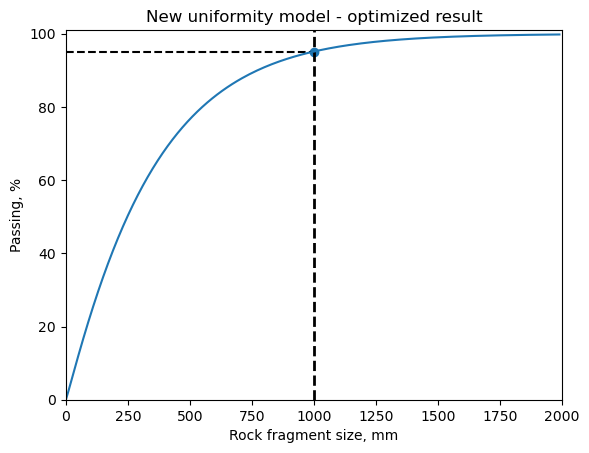

In [15]:
plot_kuz_ram_result(crusher_feed, GS_opt["X50, mm"], GS_opt["Uniformity index"], "tab:blue", True)

plt.title("New uniformity model - optimized result")
plt.show()

Although the total mining costs are slightly, increased (from 113.80 kEUR to 116.75 kEUR), the reduced oversize (from 7.50% to 4.92%) leads to fewer downstream costs - such as less secondary breakage costs and less crushing costs. As it was already mentioned, it is difficult to estimate crushing costs based on theoretical formulae. Nonetheless, up to 5% oversize is considered to be best for a mining operation as a rule of thumb. Furthermore, the observed difference between the total costs in both cases are assumed for a signle value of the presupposed Rock factor. In practical cases, the assumed value may or may not be similar to the actual one, as the rockmass is heterogenous. Therefore, it should also be investigated whether the obtained solution is otpimal in different scenarios when the Rock factor and the rockmass' strength assumes different values. However, this is further discussed in *Vol. 3 - Monte Carlo simulation and Hypothesis testing*. For this particular scenario of the assumed Rock factor value, an illustration of the estimated costs can be seen on the Pareto chart below.

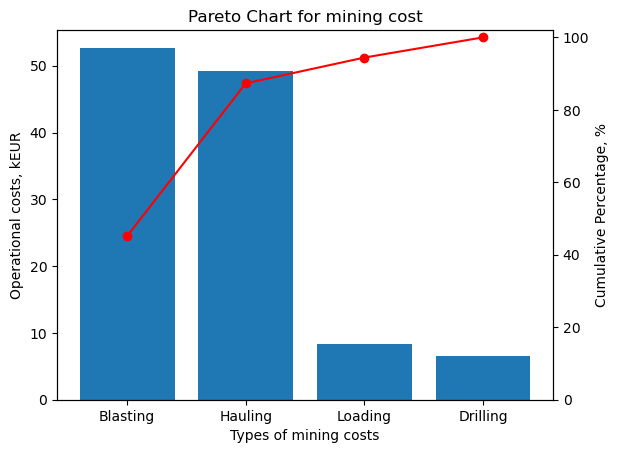

In [16]:
GS_opt_costs_dict = {"Drilling": GS_opt["Drilling costs, kEUR"], 
                      "Blasting": GS_opt["Blasting costs, kEUR"], 
                      "Loading": GS_opt["Loading costs, kEUR"], 
                      "Hauling": GS_opt["Haul costs, kEUR"]}

pareto_chart(GS_opt_costs_dict)

Once more, Blasting costs tend to be the most important ones, followed by Hauling costs. In terms of practical interpretation, in order to further minimize costs on the mining operation, the optimization approach can be taken into consideration for different aspects of the assumed blasting and hauling methods. For example, in future studies a thorough attention would deserve the comparison of using supplements for blasting agents, which can increase their energy and at the same time reduce their required amount for blasting. Additionally, different models of haul trucks can also be investigated for estiamting the best case scenario.

### Results interpretation
In terms of obtaining a realistic solution, there are no concerns regardind the proposed solution. However, it should be further investigated how different blast design parameters affect different optimization criteria.
Let's start with finding out how blast design parameters affect the Mean fragment size (X50) and the Uniformity index (n).

First, we need to vectorize the mining operation function `mining_ops` in order to use it with arrays of the design parameters as arguments.

In [17]:
vectorized_mining_ops = np.vectorize(mining_ops)

Second, we need to define the range and step size for each design pattern when calculating the objective function.

In [18]:
bp_burden_range = np.arange(bp_burden_min, bp_burden_max, (bp_burden_max - bp_burden_min)/100)
bp_spacing_range = np.arange(bp_spacing_min, bp_spacing_max, (bp_spacing_max - bp_spacing_min)/100)
bp_subdrilling_range = np.arange(bp_dh_subdrilling_min, bp_dh_subdrilling_max, (bp_dh_subdrilling_max - bp_dh_subdrilling_min)/100)
bp_stemming_range = np.arange(bp_dh_stemming_min, bp_dh_stemming_max, (bp_dh_stemming_max - bp_dh_stemming_min)/100)

Now let's test how each design feature affect both Oversize and Total costs. But first, we need to define a function which takes the Overszie and Total costs values from the array of dictionaries for all solutions from the vectorized function `mining_ops`

In [19]:
def return_z_array(Z, criteria):
    '''Returns a nd.array for the calculated criteria values in different design scenarios'''
    
    c = np.array([d[criteria] for d in Z])
    
    return c

And here are the x, y, z valeus for the scatter plot, which would help us get a better understanding. It should be pointed out that for this graph all parameters were assuemd to be constant, except for one. This could be interpreted as a "sensitivity" analysis of how each parameter influences the outcome criteria.

The Oversize rock fragments parameters serves as an indicator of the degree of fragmentation, as it manages to implement both the Uniformity index and the Mean rock fragment size. In addition, it should be pointed out the 3D graph utilizes the optimal solution values from the Grid search method for all constant parameters. 

In [20]:
BURDEN_test = np.arange(bp_burden_min, bp_burden_max, 0.05)
Z_burden = vectorized_mining_ops(BURDEN_test, GS_opt["Spacing, m"], GS_opt["Subdrilling, m"], GS_opt["Stemming, m"])
y1, z1= return_z_array(Z_burden, "Oversize, %"), return_z_array(Z_burden, "Total costs, kEUR")

In [21]:
SPACING_test = np.arange(bp_spacing_min, bp_spacing_max, 0.05)
Z_spacing = vectorized_mining_ops(GS_opt["Burden, m"], SPACING_test, GS_opt["Subdrilling, m"], GS_opt["Stemming, m"])
y2, z2 = return_z_array(Z_burden, "Oversize, %"), return_z_array(Z_burden, "Total costs, kEUR")

In [22]:
SUBDRILLING_test = np.arange(bp_dh_subdrilling_min, bp_dh_subdrilling_max, 0.05)
Z_subdrilling = vectorized_mining_ops(GS_opt["Burden, m"], GS_opt["Spacing, m"], SUBDRILLING_test, GS_opt["Stemming, m"])
y3, z3 = return_z_array(Z_burden, "Oversize, %"), return_z_array(Z_burden, "Total costs, kEUR")

In [23]:
STEMMING_test = np.arange(bp_dh_stemming_min, bp_dh_stemming_max, 0.05)
Z_stemming = vectorized_mining_ops(GS_opt["Burden, m"], GS_opt["Spacing, m"], GS_opt["Subdrilling, m"], STEMMING_test)
y4, z4 = return_z_array(Z_burden, "Oversize, %"), return_z_array(Z_burden, "Total costs, kEUR")

Here is an interactive plot on how different design parameters can influence Total costs and the Oversize fragments percentage. Additionally, one can see how the Oversize fragments percentage can influence the Total costs.

In [24]:
fig = go.Figure()

# Add trace for set of points related to Burden results
fig.add_trace(
    go.Scatter3d(
        x = BURDEN_test,
        y = y1,
        z = z1,
        mode = "markers",
        marker = dict(
            color = "purple",
            size = 5),
        name = "Burden")
)

# Add trace for set of points related to Spacing results
fig.add_trace(
    go.Scatter3d(
        x = SPACING_test,
        y = y2,
        z = z2,
        mode = "markers",
        marker = dict(
            color = "orange",
            size = 5),
        name = "Spacing")
)

# Add trace for set of points related to Subdrilling results
fig.add_trace(
    go.Scatter3d(
        x = SUBDRILLING_test,
        y = y3,
        z = z3,
        mode = "markers",
        marker = dict(
            color = "green",
            size = 5),
        name = "Subdrilling")
)

# Add trace for set of points related to Stemming results
fig.add_trace(
    go.Scatter3d(
        x = STEMMING_test,
        y = y4,
        z = z4,
        mode = "markers",
        marker = dict(
            color = "red",
            size = 5),
        name = "Stemming")
)

# Customize the plot
fig.update_layout(
    scene=dict(
        xaxis_title = "Parameter length, m",
        yaxis_title = "Oversize, %",
        zaxis_title = "Total costs, kEUR"
    ),
    title='Relationship between Design features, Oversize and Total costs'
)

fig.show()


From the 3D graph several important observations can be pointed out:
1. Changes in the length of the Burden and Spacing leads to a piece-wise and discontinuous behaviour for both responses (Oversize rock fragments percentage and Total costs).
2. Subdrilling and Stemming lengths have a continuous relation with the two response variables.
3. In all cases, an increase of the oversize fragments percentage leads to a decrease of the Total costs.
4. Decreasing the Subdrilling length and increasing the Burden, Spacing and Stemming lengths all lead to poor fragmentation, but less Total costs and vise versa.
5. Spacing is the most influencial parameter (the msot sensitive one) as it affects the Uniformity index, which changes the Oversize rock fragments percentage.

In the case of estimating how changes in the Burden or Spacing influence the In-size rock fragments percentage or the Total costs, this is not possible as the function is not differentiable. Nonetheless, the non-linear trend of how they influence Oversize and Total costs is visible.

In contrast to the Burden and Spacing, the derivatives can be calculated for the relation of the Burden and Spacing with the two response values. Assuming all design parameters remain constant except for the evaluated one, this graph provides a notion of how the partial derivatives for the Burden and Spacing variables would "look like".

Furthermore, this peice-wise and discontinuous behaviour is expected to be present for the higher order dimensionality of the feature space and response variables of the problem.

Now let's see how different types of costs depend on let's say the Spacing of drillholes and how they add up to the sum of Total costs.

Once more, the `return_z_array` function was used for getting all different types of costs as arrays.

In [25]:
spacing_costs = np.arange(bp_spacing_min, bp_spacing_max, 0.05)
Z_spacing = vectorized_mining_ops(GS_opt["Burden, m"], spacing_costs, GS_opt["Subdrilling, m"], GS_opt["Stemming, m"])
y_costs = return_z_array(Z_spacing, "In-size, %")
z_drill = return_z_array(Z_spacing, "Drilling costs, kEUR")
z_blast = return_z_array(Z_spacing, "Blasting costs, kEUR")
z_loading = return_z_array(Z_spacing, "Loading costs, kEUR")
z_haul = return_z_array(Z_spacing, "Haul costs, kEUR")
z_total = return_z_array(Z_spacing, "Total costs, kEUR")

And here is how to graph looks like.

In [26]:
fig = go.Figure()

# Add trace for set of points related to Burden results
fig.add_trace(
    go.Scatter3d(
        x = spacing_costs, 
        y = y_costs,
        z = z_drill,
        mode = "markers",
        marker = dict(
            color = "blue",
            size = 5),
        name = "Drilling")
)

# Add trace for set of points related to Spacing results
fig.add_trace(
    go.Scatter3d(
        x = spacing_costs, 
        y = y_costs,
        z = z_blast,
        mode = "markers",
        marker = dict(
            color = "orange",
            size = 5),
        name = "Blasting")
)

# Add trace for set of points related to Subdrilling results
fig.add_trace(
    go.Scatter3d(
        x = spacing_costs, 
        y = y_costs,
        z = z_loading,
        mode = "markers",
        marker = dict(
            color = "green",
            size = 5),
        name = "Loading")
)

# Add trace for set of points related to Stemming results
fig.add_trace(
    go.Scatter3d(
        x = spacing_costs, 
        y = y_costs,
        z = z_haul,
        mode = "markers",
        marker = dict(
            color = "red",
            size = 5),
        name = "Hauling")
)

# Add trace for set of points related to Stemming results
fig.add_trace(
    go.Scatter3d(
        x = spacing_costs, 
        y = y_costs,
        z = z_total,
        mode = "markers",
        marker = dict(
            color = "purple",
            size = 5),
        name = "Total")
)

# Customize the plot
fig.update_layout(
    scene=dict(
        xaxis_title = "Spacing, m",
        yaxis_title = "In-size fragments, %",
        zaxis_title = "Operational costs, kEUR"
    ),
    title='Relationship between Design features, Oversize and Total costs'
)

fig.show()

As it can be observed, let's acknowoledge that it resembles the figure from the beginning of the notebook.
In addition, the chart follows the same relation for cost types as the Pareto diagram. The behaviour of the Blasting costs is the one the Total costs function resembles the most.

#### Compound effect of Burden and Spacing on blasting results

Now that we know the general dependencies between the four diferrent design parameters and the In-size rock fragments percentage and Total costs value, let's take a look how different potential optimization criteria change when 2 design factors are considered to be variables at the same time. We will start with the investigation of how Burden and Spacing influence blasting results.

But first, a function is defined which calculates the objective function and returns a value, depending on a user-input criteria (e.g. X50, Total costs, etc.).

In [27]:
def get_z(Z_array, criteria):
    z_criteria = [[d[criteria] for d in r] for r in Z_array]
    return np.array(z_criteria)

And of course, let's not forget our plotting function for obtaining a 3D graph in order to examine the influence of different design parameters on the choice of criteria. This graphing function uses the `plotly` Python packages for its uperb visuals and interactive plots.

In [28]:
def plot_criteria_3D_graph(X, Y, z, X_label, Y_label, Z_label, constraint_z = None, color = "Viridis"):
    '''Plots 3D graph for the influence of X and Y on a user-defined critera Z.
    Additionally, if any constraints are defined, they are plotted as well.'''
    
    Z = get_z(z, Z_label)
    fig_criteria = go.Surface(x = X, y = Y, z = Z, 
                              colorscale = color, 
                              colorbar = dict(title = Z_label), 
                              name = Z_label)
    fig_constraint = None

    if constraint_z:
        constr_cscale = [
            [0, 'rgb(255, 165, 0)'],
            [1, 'rgb(255, 165, 0)']]
            
        Z_constr = np.array([[constraint_z] * len(X)] * len(Y))
        fig_constraint = go.Surface(x = X, y = Y, z = Z_constr, 
                                    colorscale = constr_cscale, 
                                    colorbar = dict(title = "Constraint"), 
                                    showscale = False,
                                    name = "Contraint")
        
        fig = go.Figure(data=[fig_criteria, fig_constraint])
    else:
        fig = go.Figure(data=[fig_criteria])

    fig.update_layout( title = f"{X_label} and {Y_label} influence on {Z_label}",
                      scene = dict(
                          xaxis_title = f"{X_label}, m",
                          yaxis_title = f"{Y_label}, m",
                          zaxis_title = f"{Z_label}")
                     )
        
    fig.show()

And here is how the compound effect of Burden and Spacing on the Mean fragment size looks like.

In [29]:
burden_comp, spacing_comp = np.meshgrid(bp_burden_range, bp_spacing_range)
Z_bs = vectorized_mining_ops(burden_comp, spacing_comp, GS_opt["Subdrilling, m"], GS_opt["Stemming, m"])

plot_criteria_3D_graph(burden_comp, spacing_comp, Z_bs, "Burden", "Spacing", "X50, mm")

As it can be observed, the more scattered the blasting pattern, the bigger the Mean fragment size is. Furthermore, the relationship between the Mean rock fragment size and the Burden and Spacing seems to resemble a linear relationship when one of the two parameters remains a constant (although the relation is non-linear). The denser tha drilling pattern, the smaller the rock fragments and vise versa.

Let's see how both parameters affect the Uniformity index.

In [30]:
plot_criteria_3D_graph(burden_comp, spacing_comp, Z_bs, "Burden", "Spacing", "Uniformity index")

As it can be seen from the figure, the Burden and Spacing parameters have a non-linear relationship with the Uniformity index, as the formula suggests:

$n = \left(2.2 - 14\frac{B}{D}\right)\left(\frac{1}{2} + \frac{S}{2B}\right)^{0.5}\left(1 - \frac{W}{B}\right)\left(\frac{L}{H}\right)$

Hence, the denser the drilling patter, the better the uniformity of the material would be.

Now, let's examine their effect on Oversize and In-size percentages.

In [31]:
plot_criteria_3D_graph(burden_comp, spacing_comp, Z_bs, "Burden", "Spacing", "Oversize, %", max_oversize_p)

Things look a bit more interesting here. We can see that the function exponentially reises when the drilling pattern becomes too wide and irregular. Once more, the denser the pattern the less overall Oversize is expected. However, it should be noted that the orange plane represents the Oversize constraint and therefore, all the feasible solution would lie no higher than itself.

Now let's see how the other constraint for the achievable drilling lentgth is respected for our solution.

In [32]:
plot_criteria_3D_graph(burden_comp, spacing_comp, Z_bs, "Burden", "Spacing", "Total drillhole length, m", bp_possible_total_dh_len)

The interesting part of this relation is that due to the modulo division for obtaining the number of drillholes for the blast panel, the function is piece-wise and hence is represented as a stepped surface. **It should be pointed out that the function is not continuous and this is only for visual purposes.** 

Once more, the orange plane represents the constraint of the problem. All feasible solutions lie below the plane.

Last, but not least, here is how both parameters affect the Total mining costs, based on the objective function.

In [33]:
plot_criteria_3D_graph(burden_comp, spacing_comp, Z_bs, "Burden", "Spacing", "Total costs, kEUR")

Indeed, the piece-wise nature of the objective function remains in a higher dimension as well. An overall, conc;usion, which can be drawn is that the total costs increae drastically when the blasting pattern becomes too dense. This is because the total drilling length also behaves in a similar fashion. Once more **it should be pointed out that the function is not continuous and this is only for visual purposes.** 

#### Compound effect of Subdrilling and Stemming on blasting results

Now taht we covered how the Burden and Stemming affect several of the most import aspects of blasting results, let's see how the Subdrilling and Stemming affect different outcomes.

In [34]:
subdrilling_comp, stemming_comp = np.meshgrid(bp_subdrilling_range, bp_stemming_range)
Z_ss = vectorized_mining_ops(GS_opt["Burden, m"], GS_opt["Spacing, m"], subdrilling_comp, stemming_comp)

plot_criteria_3D_graph(subdrilling_comp, stemming_comp, Z_ss, "Subdrilling", "Stemming", "X50, mm")

Once more, they follow a slight non-linear behaviour with the Mean fragment size. It is understandable that bigger stemming and small Subdrilling leads to poor fragmentation.

How about their influence on the Uniformity index?

In [35]:
plot_criteria_3D_graph(subdrilling_comp, stemming_comp, Z_ss, "Subdrilling", "Stemming", "Uniformity index")

This graph shows similar results to the ones for the Mean fragment size. Once more, bigger Stemming and insufficient Subdrilling lead to worse fragments uniformity, and vise versa.

In [36]:
plot_criteria_3D_graph(subdrilling_comp, stemming_comp, Z_ss, "Subdrilling", "Stemming", "Oversize, %", max_oversize_p)

It is interesting to see how the Oversize constraint is located, compared to the relationship between Stemming, Subdrilling and Oversize. Only a small portion of design alternatives remains unfeasible (the oen above the orange plane).

In terms of the second constraint (the achievable drilling lentgth), all design alternatives are feasible.Furthermore, Stemming length does not affect the Total drillholes lenght, which is self-explanatory, while the subdrilling length affect the criteria in a linear fashion.

In [37]:
plot_criteria_3D_graph(subdrilling_comp, stemming_comp, Z_ss, "Subdrilling", "Stemming", "Total drillhole length, m", bp_possible_total_dh_len)

And last, we need to check how the relationship of both parameters with the Total costs looks like.

In [38]:
plot_criteria_3D_graph(subdrilling_comp, stemming_comp, Z_ss, "Subdrilling", "Stemming", "Total costs, kEUR")

This time, the relationship is linear. However, Stemming seems to affect the Total costs more, as it can span over a wider range and hence, its affect on the cost is additive for all drillholes.

Now that we have a grasp of how the feasible space looks like, let's apply a more efficient optimziation algorithm in terms of computational time.
Unofrtunately, the renowned Gradient descent method is not a suitable optimization method in this case, as the objective function (Total costs) is a non-differentiable function. However, a similar method can be used in this case without the need of using derivatives - the Coordinate descent method.

## Random search method
### Overview

Random search (RS) encompasses a range of numerical optimization approaches that do not rely on the gradient of the problem being optimized. As a result, RS can be employed with functions that lack continuity or differentiability. These optimization methods are alternatively known as direct-search, derivative-free, or black-box methods.
This methods has many modifications including:
- Direction penalization
- Search radius adaptation, etc

This case study the most basic form of the Random search method which follows the following steps for $x_{i} \in \mathbb{R}^{n}, i \in \mathbb{N}$,:
1. Initialize $x_{i}$ with a random position in the search-space and evaluate the objective function.
2. Sample a new position $x_{i+1}$ from the hyperspace
3. If $f(x_{i+1}) < f(x)$ then save its value to the current best solution
4. Evaluate each objective function for each $x$ and $y$ until a termination criterion is met (number of iterations)

This concept can be interpreted by the following figure:

<img src="https://www.section.io/engineering-education/random-search-hyperparameters/randomgrid.png"  width="30%">

The way each random is being generated can be achieved in the following way:

$x_{i} = x_{\text{min i}} + \alpha_{i}(x_{\text{max i}} - x_{\text{min i}})$

where $\alpha_{i}$ is uniformly distributed random variable in the interval $[0, 1]$.

### Solution

This algorithm does not requrie a predefined starting point, as it generates the first point by random. However, we are interested in the solutions which achieve Total costs no higher than 200 kEUR. SImilarly to the Grid search method, the optimal solution is saved as a dictionary 

In [39]:
RS_opt = {} # Dictionary for optimal solution
RS_cur = {} # Dictionary for current evaluated solution
RS_opt_costs = 200 # Current best solution mining costs, kEUR

RS_iter_cnt = 0 # Iteration counter
RS_iter_array = [] # Iterations list
RS_sol_array = [] # Best solution for each iteration list

iterations = 750000 # User defined stopping criteria

And here is the implementation fo the Random search method.

In [40]:
# Random search algorithm implementaion

RS_start_time = time.time()

for _ in range(iterations):
    random_b = bp_burden_min + round(np.random.rand() * (bp_burden_max - bp_burden_min), 2)
    random_s = bp_spacing_min + round(np.random.rand() * (bp_spacing_max - bp_spacing_min), 2)
    random_sd = bp_dh_subdrilling_min + round(np.random.rand() * (bp_dh_subdrilling_max - bp_dh_subdrilling_min), 2)
    random_st = bp_dh_stemming_min + round(np.random.rand() * (bp_dh_stemming_max - bp_dh_stemming_min), 2)
      
    RS_cur = mining_ops(random_b, random_s, random_sd, random_st)
    
    if RS_cur["Oversize, %"] < max_oversize_p and \
    RS_cur["Total costs, kEUR"] < RS_opt_costs and \
    RS_cur["Total drillhole length, m"] < bp_possible_total_dh_len:
        RS_opt_costs = RS_cur["Total costs, kEUR"]
        RS_opt = RS_cur
    
    RS_iter_cnt += 1  
    RS_sol_array.append(RS_opt_costs)
    RS_iter_array.append(RS_iter_cnt)
    
RS_end_time = time.time()

The solutions of the Random search method can be shown here below:

In [41]:
for k,v in RS_opt.items():
    print(f"{k}: {v:.2f}")

Burden, m: 4.53
Spacing, m: 5.95
Stemming, m: 6.49
Subdrilling, m: 1.15
DH length, m: 16.15
DH expl. mass, kg: 333.83
DH spec. charge, kg/m³: 0.83
Rows: 6.00
Holes per row: 17.00
Total number of drillholes: 102.00
Total drillhole length, m: 1647.30
Total explosive mass, kg: 34050.21
Drilling costs, kEUR: 6.57
Blasting costs, kEUR: 51.42
Loading costs, kEUR: 8.31
Haul costs, kEUR: 49.28
Total costs, kEUR: 115.58
X50, mm: 250.06
Uniformity index: 1.06
Oversize, %: 4.94
In-size, %: 95.06


In [42]:
RS_time = RS_end_time - RS_start_time

print(f"The Random search method required {RS_iter_cnt} iterations and has found the best solution in {RS_time:.2f} s.")

The Random search method required 750000 iterations and has found the best solution in 10.74 s.


## Search with Accelerated step size

### Overview
A different approach, similar to the Grid search is the so called Search with an accelerated step size. Although the search with a fixed step size appears to be very simple, its major limitation comes because of the unrestricted nature of the region in which the minimum can lie. Hence, this involves a large amount of computational work. An obvious improvement can be achieved by increasing the step size gradually until the minimum point is bracketed. One possibility is to reduce the step length after bracketing the optimum for all the design factors. By starting either from edges of the bracket, the basic procedure for the grid search method can be applied, however with a reduced step size. This procedure can be repeated until the bracketed interval becomes sufficiently small. The fgiure below provides a bsic visual understanding of how the method works.


<img src="https://ars.els-cdn.com/content/image/1-s2.0-S0166361522002275-gr8.jpg"  width="60%">

Furthermore, the Accelerated step size method is suitable for this case, as the objective function is discontinued. However, the optimal solution is bounded by the assumed constraints and therfore . Furthermore, from the observed graphs from the initial solution, it is expected that when the result from each iteration reaches a region near either of the constraints, this would guarantee that the solution would be improved with an accuracy no less than the desired one. Hence, the last iteration is expected to reach the optimal solution at a better or equal accuracy to the one assumed.

The implementation of the algorithm follows these steps:
1. Execute Grid search algorithm with the current step size in the defined limits for all design variables 
2. After the current best solution is found, the bracket around it is formed by the recalculating the limits for the next search iteration by using the current step size. 
3. The search step size for the current bracket is then reduced with the user-defined scale factor (2 times). 
4. The process is repeated from Step 1 to Step 3 until the step size is no bigger than the desired step size precision.

The range for each decision variable/design feature ($X_{i}$) are calculated in the following way:

$\Delta_{i} = \frac{x_{\text{max i}} - x_{\text{min i}}}{L}$

where $\Delta_{i}$ is the step size for each sequential iteration

$L$ is a natural number which requires the number of subdivisions of the range for each design feature $i$

The new limits for each design feature $X_{i}$ are determined the following way:

$x_{min} = 
\begin{cases}
    x_{min}, & \text{if } {x_{cur}}^{*} - \Delta \leq x_{min} \\
    {x_{cur}}^{*} - \Delta,  & \text{if } {x_{cur}}^{*} - \Delta > x_{min}
\end{cases}$


$x_{max} = 
\begin{cases}
    x_{max}, & \text{if } {x_{cur}}^{*} + \Delta \geq x_{min} \\
    {x_{cur}}^{*} + \Delta,  & \text{if } {x_{cur}}^{*} - \Delta > x_{max}
\end{cases}$

where ${x_{cur}}^{*}$ is the point, where the current optimal solution is obtained.

### Desired precision for design parameters

For the initial grid it was assumed that the step size for each parameter would be 0.2 m so that the most feasible region can be breacketed faster. The assumed desired percision for each design variable for this case study is 0.01 m. In addition, the scale factor for reducing the step size of each design variable is assumed to be 2.

In [43]:
# Current step size array for design features
cur_step_size = {"Burden, m": 0.2, "Spacing, m": 0.2, "Subdrilling, m": 0.2, "Stemming, m": 0.2} 

# Final size array for design features
final_step_size = {"Burden, m": 0.01, "Spacing, m": 0.01, "Subdrilling, m": 0.01, "Stemming, m": 0.01}

# Scale factor for reducing the step size for each design feature
scale = 4

Initially, no design feature requires grid rescaling. For this reason a dictionary was created in order to store a Boolean value for all design parameters, which require grid rescaling.

In [44]:
flag_dict = {"Burden, m": False, "Spacing, m": False, "Subdrilling, m": False, "Stemming, m": False}

### Constraints

The constraints for this method are similar to the ones used in the Grid search technique, howver, this time they are presented as a dictionary.

In [45]:
# Constraint list for design features
constraints = {"Burden, m": [bp_burden_min, bp_burden_max], 
                "Spacing, m": [bp_spacing_min, bp_spacing_max], 
                "Subdrilling, m": [bp_dh_subdrilling_min, bp_dh_subdrilling_max], 
                "Stemming, m": [bp_dh_stemming_min, bp_dh_stemming_max]}

### Solution
The dictionary `cur_limits` is used for tracking the current limits for all decision variables. 
The `range_dict` variable is used to store the values used for calculating the objective function for each decision variable, depending on the current constraints and step size.
The `SASS_opt` variable is used to store the last best Total costs result. Initially it assumes a large value, so that the first iteration substitutes it. The `SASS_opt` dictionary stores all the information for the optimal solution.

In [46]:
cur_limits = constraints # Constraint dictionary for all design features
range_dict = {} # Range dictionary for all design features, which is updated for each bracket

SASS_opt = {} # Dictionary for optimal solution
SASS_cur = {} # Dictionary for current evaluated solution
SASS_opt_costs = 200 # Current best solution mining costs, kEUR

SASS_iter_cnt = 0 # Iteration counter
SASS_iter_array = [] # Iterations list
SASS_sol_array = [] # Best solution for each iteration list

And here is the implementation of the algorithm.

In [47]:
# Search with Accelerated step size
time_start = time.time()

while cur_step_size["Burden, m"] > final_step_size["Burden, m"] and \
cur_step_size["Spacing, m"] > final_step_size["Spacing, m"] and \
cur_step_size["Subdrilling, m"] > final_step_size["Subdrilling, m"] and \
cur_step_size["Stemming, m"] > final_step_size["Stemming, m"]:
    for key in cur_step_size.keys():
        if flag_dict[key]:
            cur_step_size[key] /= scale
        flag_dict[key] = False
        
        range_dict[key] = np.arange(cur_limits[key][0], cur_limits[key][1] + cur_step_size[key], cur_step_size[key])
    
    for b in range_dict["Burden, m"]:
        for s in range_dict["Spacing, m"]:
            for sd in range_dict["Subdrilling, m"]:
                for st in range_dict["Stemming, m"]:
                    b = round(b,2)
                    s = round(s, 2)
                    sd = round(sd, 2)
                    st = round(st, 2)
                    SASS_cur = mining_ops(b, s, sd, st)
                    SASS_iter_cnt += 1
                    
                    if SASS_cur["Oversize, %"] < max_oversize_p and \
                    SASS_cur["Total costs, kEUR"] < SASS_opt_costs and \
                    SASS_cur["Total drillhole length, m"] < bp_possible_total_dh_len:
                        SASS_opt_costs = SASS_cur["Total costs, kEUR"]
                        SASS_opt = SASS_cur
                    
                    SASS_sol_array.append(SASS_opt_costs)
                    SASS_iter_array.append(SASS_iter_cnt)
    
    for key in cur_step_size.keys():        
        if cur_step_size[key] > final_step_size[key]:
            if cur_limits[key][0] < SASS_opt[key] - 3 * cur_step_size[key]:
                cur_limits[key][0] = SASS_opt[key] - 3 * cur_step_size[key]
            if cur_limits[key][1] > SASS_opt[key] + 3 * cur_step_size[key]:
                cur_limits[key][1] = SASS_opt[key] + 3 * cur_step_size[key]
            flag_dict[key] = True
            

time_end = time.time()

The solution for the Search with an accelerated step size yields the following result:

In [48]:
for k, v in SASS_opt.items():
    print(f"{k}: {v:.2f}")

Burden, m: 4.51
Spacing, m: 5.89
Stemming, m: 6.46
Subdrilling, m: 1.00
DH length, m: 16.00
DH expl. mass, kg: 329.68
DH spec. charge, kg/m³: 0.83
Rows: 6.00
Holes per row: 17.00
Total number of drillholes: 102.00
Total drillhole length, m: 1632.00
Total explosive mass, kg: 33627.23
Drilling costs, kEUR: 6.51
Blasting costs, kEUR: 50.78
Loading costs, kEUR: 8.31
Haul costs, kEUR: 49.27
Total costs, kEUR: 114.86
X50, mm: 249.13
Uniformity index: 1.05
Oversize, %: 4.97
In-size, %: 95.03


In [49]:
SASS_time = time_end - time_start

print(f"The Search with an accelerated step size required {SASS_iter_cnt} iterations and has found the best solution in {SASS_time:.2f} s.")

The Search with an accelerated step size required 439642 iterations and has found the best solution in 14.55 s.


## Comparsion between utilized optimization methods

### Results interpretation
The Random search method did not converge to the global optimum and hence this algorithm requires improvement. However, a neat feature of this algorithm that for a small numbers of iterations it has a very good convergence rate compared to the other two algorithms.

Due to the non-convex constraints of the problem, the Search with an Accelerated step size fails to find the true optimal solution in its traditional form. One modification, which could prove to be useful in this case is to artificially increase the scanning window for the newly formed bracket. 
In this case increasing the window 4 times manages to provide a good way for obtaining an improved solution, depsite the increaed number of iterations. Therefore, although the Search with an accelerated step size is significantly faster, it also could lead to local a optimum, when working with non-convex constraints.
Hence, for future work on this problem, global otpimization techniques have to be further investigated and compared to these two traditional methods. (The Coordinate descent method was also used, but it remains in the draft, as it did not converge to a optimal solution for these constraints.)



The convergence rate of all three algorithms is shown in the figure below:

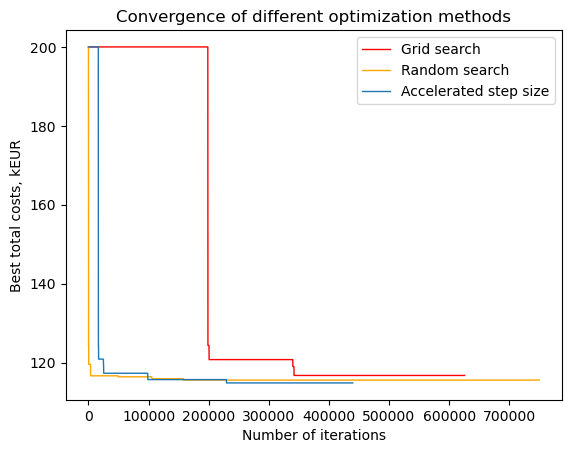

In [50]:
plt.plot(GS_iter_array, GS_sol_array, color = "red", label = "Grid search", linewidth = 1)
plt.plot(RS_iter_array, RS_sol_array, color = "orange", label = "Random search", linewidth = 1)
plt.plot(SASS_iter_array, SASS_sol_array, color = "tab:blue", label = "Accelerated step size", linewidth = 1)
plt.xlabel("Number of iterations")
plt.ylabel("Best total costs, kEUR")

plt.legend()
plt.title("Convergence of different optimization methods")
plt.show()

The following bar chart represents the number of iterations of the used algorithms.It is evident that the Accelerated step size search algorithm requires the least number of iterations, compared to the other two.

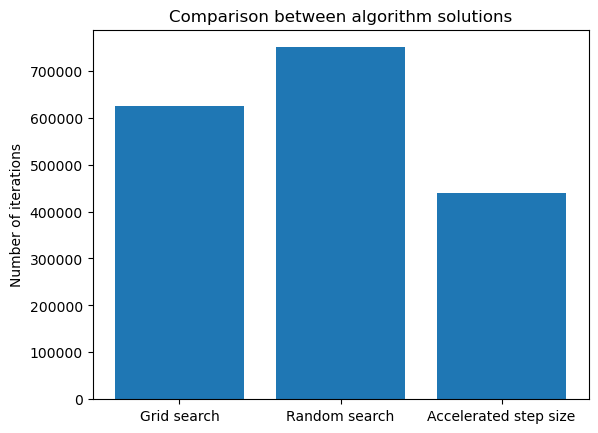

In [51]:
plt.bar(["Grid search", "Random search", "Accelerated step size"], 
        [GS_iter_cnt, RS_iter_cnt, SASS_iter_cnt])
plt.ylabel("Number of iterations")
plt.title("Comparison between algorithm solutions")

plt.show()

However, it should be pointed out that the number of iteratiosn required for the Grid search algorithm can increase exponentially, should a better percision of the design features is required.

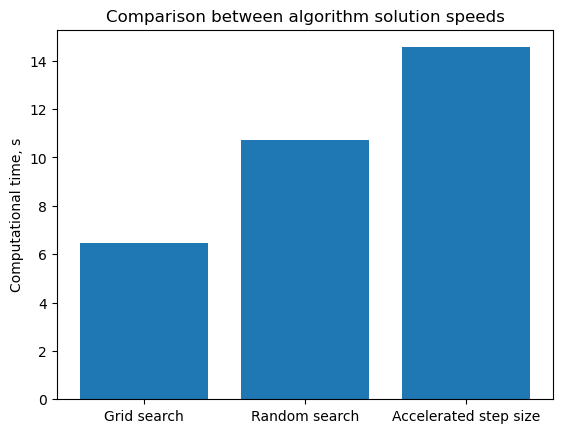

In [52]:
plt.bar(["Grid search", "Random search", "Accelerated step size"], 
        [GS_time, RS_time, SASS_time])
plt.ylabel("Computational time, s")
plt.title("Comparison between algorithm solution speeds")

plt.show()

Similar results can be seen for the computational tiem required for obtaining a solution.

*Note: The Grid search's computational time can increase exponentially when a better preceision is desired.*

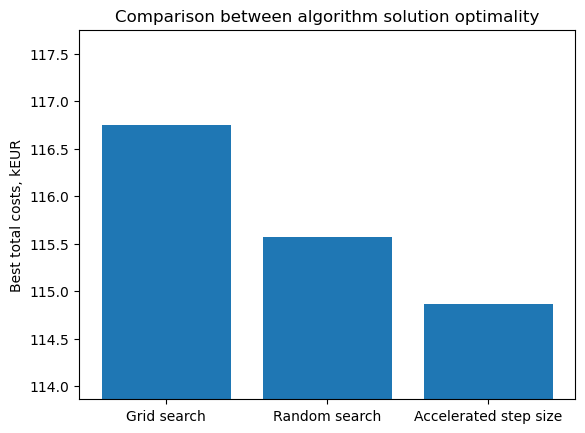

In [53]:
plt.bar(["Grid search", "Random search", "Accelerated step size"], 
        [GS_opt["Total costs, kEUR"], RS_opt["Total costs, kEUR"], SASS_opt["Total costs, kEUR"]])
plt.ylabel("Best total costs, kEUR")
plt.ylim(SASS_opt["Total costs, kEUR"] - 1, GS_opt["Total costs, kEUR"] + 1)
plt.title("Comparison between algorithm solution optimality")

plt.show()

From the figure above one can see that the Accelerated step search provides a slightly improved solution, compared to the Random search solution.

## Conclusion

In this volume we dicussed how different optimziation algorithms can be applied for estiamting the best design features for the blast design case study. Furthermore, it was established that the optimziation problem is a non-convex one and that the objective function is discontinued and piece-wise. Hence, this requried the use of optimziation techniques which do not assume a continuous behaviour of the objective function and this lead us to the use of non-gradient methods. In addition, we examined how traditional algortihms such as the Grid search, the Random search and the Search with an accelerated step size perform for this case study. This examples give an initial notion how these three groups of algorithms perform in such an environment and hence, for future studies, more advanced methods should be used.

In addition, the optimal solutions required an increase in the Total costs, but they managed to respect all technological constraints. However, whether these solutions remain optimal and whether they remain ranked in this order, should be furtehr examnined. Stay tuned for *Vol. 3. Monte Carlo simulation*